In [1]:
%pip install git+https://github.com/tensorflow/examples.git

Note: you may need to restart the kernel to use updated packages.Collecting git+https://github.com/tensorflow/examples.git
  Cloning https://github.com/tensorflow/examples.git to c:\users\chris\appdata\local\temp\pip-req-build-9tdvit4o
  Resolved https://github.com/tensorflow/examples.git to commit fff4bcda7201645a1efaea4534403daf5fc03d42
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'



  Running command git clone --filter=blob:none --quiet https://github.com/tensorflow/examples.git 'C:\Users\chris\AppData\Local\Temp\pip-req-build-9tdvit4o'


In [2]:
#%pip install tensorflow==2.10.1

In [3]:
%pip install tensorflow_io==0.27.0


Note: you may need to restart the kernel to use updated packages.


In [4]:
%pip install pydot

Note: you may need to restart the kernel to use updated packages.


In [5]:
from pathlib import Path

import tensorflow as tf
import tensorflow_io as tfio

print(tf.__version__)
print(tfio.__version__)

2.10.1
0.27.0


In [6]:
# Defining ancillary functions to preprocess the images
def normalize(input_image, input_mask):
    input_image = tf.cast(input_image, tf.float32) / 255.0
    input_mask = (input_mask // 255)
    return input_image, input_mask

def load_image(datapoint):
    input_image = tf.image.resize(datapoint['image'], (256, 256))
    input_mask = tf.image.resize(
        datapoint['segmentation_mask'],
        (256, 256),
        method = tf.image.ResizeMethod.NEAREST_NEIGHBOR,
    )
    input_image, input_mask = normalize(input_image, input_mask)
    input_mask = input_mask[0][ :, :, 0]
    input_mask = tf.expand_dims(input_mask, -1)
    return input_image, input_mask

def parse_image(img_path: str, mask_path:str):
    image = tf.io.read_file(img_path)
    image = tfio.experimental.image.decode_tiff(image)
    image = tf.image.convert_image_dtype(image, tf.uint8)
    r, g, b = image[:, :, 0], image[:, :, 1], image[:, :, 2]
    image = tf.stack([r, g, b], axis=-1)
    mask = tf.io.read_file(mask_path)
    mask = tf.io.decode_gif(mask)
    return {'image': image, 'segmentation_mask': mask}
    
training_images_main_path = Path("/Users/chris/Documents/GitHub/BMEN509-UCID00306622/Final_Project/DRIVE/training/images")
training_label_main_path = Path("/Users/chris/Documents/GitHub/BMEN509-UCID00306622/Final_Project/DRIVE/training/1st_manual")
testing_images_main_path = Path("/Users/chris/Documents/GitHub/BMEN509-UCID00306622/Final_Project/DRIVE/test/images")
testing_mask_main_path = Path("/Users/chris/Documents/GitHub/BMEN509-UCID00306622/Final_Project/DRIVE/test/mask")

training_images = tf.data.Dataset.list_files(str(training_images_main_path/'*'), shuffle=False) 
training_labels = tf.data.Dataset.list_files(str(training_label_main_path/'*'), shuffle=False) 
testing_images = tf.data.Dataset.list_files(str(testing_images_main_path/'*'), shuffle=False)
testing_masks = tf.data.Dataset.list_files(str(testing_mask_main_path/'*'), shuffle=False)
dataset = tf.data.Dataset.zip((training_images, training_labels))
test_dataset = tf.data.Dataset.zip((testing_images, testing_masks))

# Preprocessing images
images = dataset.map(parse_image, num_parallel_calls=tf.data.AUTOTUNE)
train_images = images.map(load_image, num_parallel_calls=tf.data.AUTOTUNE)

testing_images = test_dataset.map(parse_image, num_parallel_calls=tf.data.AUTOTUNE)
test_images = testing_images.map(load_image, num_parallel_calls=tf.data.AUTOTUNE)


# Establishing the basics for training based on training dataset size
TRAIN_LENGTH = len(dataset)
BATCH_SIZE = 3
BUFFER_SIZE = 1000
STEPS_PER_EPOCH = TRAIN_LENGTH // BATCH_SIZE

# Dividing the data into their respective training and test sets
train_batches = (
    train_images
    .cache()
    .shuffle(BUFFER_SIZE)
    .batch(BATCH_SIZE)
    .repeat()
    .prefetch(buffer_size=tf.data.AUTOTUNE))

test_batches = (
    test_images
    .batch(BATCH_SIZE)
)

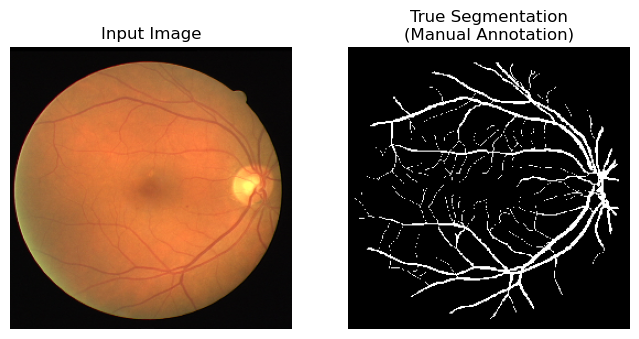

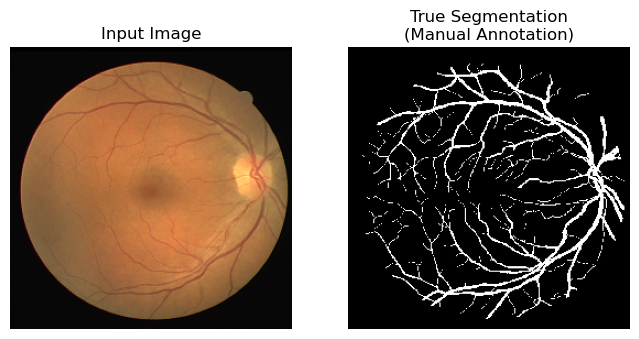

In [7]:
import matplotlib.pyplot as plt
import numpy
from IPython.display import display
    
for images, masks in train_batches.take(2):
    sample_image, sample_mask = images[0], masks[0]
    plt.subplots(1, 2, figsize=(8,8))
    plt.subplot(121);plt.imshow(sample_image); plt.title('Input Image'); plt.axis('off')
    plt.subplot(122);plt.imshow(sample_mask, cmap='gray'); plt.title('True Segmentation\n(Manual Annotation)'); plt.axis('off')
    

In [8]:
# Confirming the shape of each image and mask
print(sample_image.shape)
print(sample_mask.shape)


(256, 256, 3)
(256, 256, 1)


In [9]:
# Building the model
from tensorflow_examples.models.pix2pix import pix2pix
tf.config.run_functions_eagerly(True)

base_model = tf.keras.applications.MobileNetV2(input_shape=[256, 256, 3], include_top=False)

# Use the activations of these layers
layer_names = [
    'block_1_expand_relu',   # 64x64
    'block_3_expand_relu',   # 32x32
    'block_6_expand_relu',   # 16x16
    'block_13_expand_relu',  # 8x8
    'block_16_project',      # 4x4
]
base_model_outputs = [base_model.get_layer(name).output for name in layer_names]

# Create the feature extraction model
down_stack = tf.keras.Model(inputs=base_model.input, outputs=base_model_outputs)

down_stack.trainable = False

up_stack = [
    pix2pix.upsample(512, 3),  # 4x4 -> 8x8
    pix2pix.upsample(256, 3),  # 8x8 -> 16x16
    pix2pix.upsample(128, 3),  # 16x16 -> 32x32
    pix2pix.upsample(64, 3),   # 32x32 -> 64x64
]

def unet_model(output_channels:int):
    inputs = tf.keras.layers.Input(shape=[256, 256, 3])

    # Downsampling through the model
    skips = down_stack(inputs)
    x = skips[-1]
    skips = reversed(skips[:-1])

    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        concat = tf.keras.layers.Concatenate()
        x = concat([x, skip])

    # This is the last layer of the model
    last = tf.keras.layers.Conv2DTranspose(
      filters=output_channels, kernel_size=2, strides=2,
      padding='same')  #64x64 -> 128x128
    
    x = last(x)
    return tf.keras.Model(inputs=inputs, outputs=x)

OUTPUT_CLASSES = 2

model = unet_model(output_channels=OUTPUT_CLASSES)
model.summary()


Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 model (Functional)             [(None, 128, 128, 9  1841984     ['input_2[0][0]']                
                                6),                                                               
                                 (None, 64, 64, 144                                               
                                ),                                                                
                                 (None, 32, 32, 192                                         

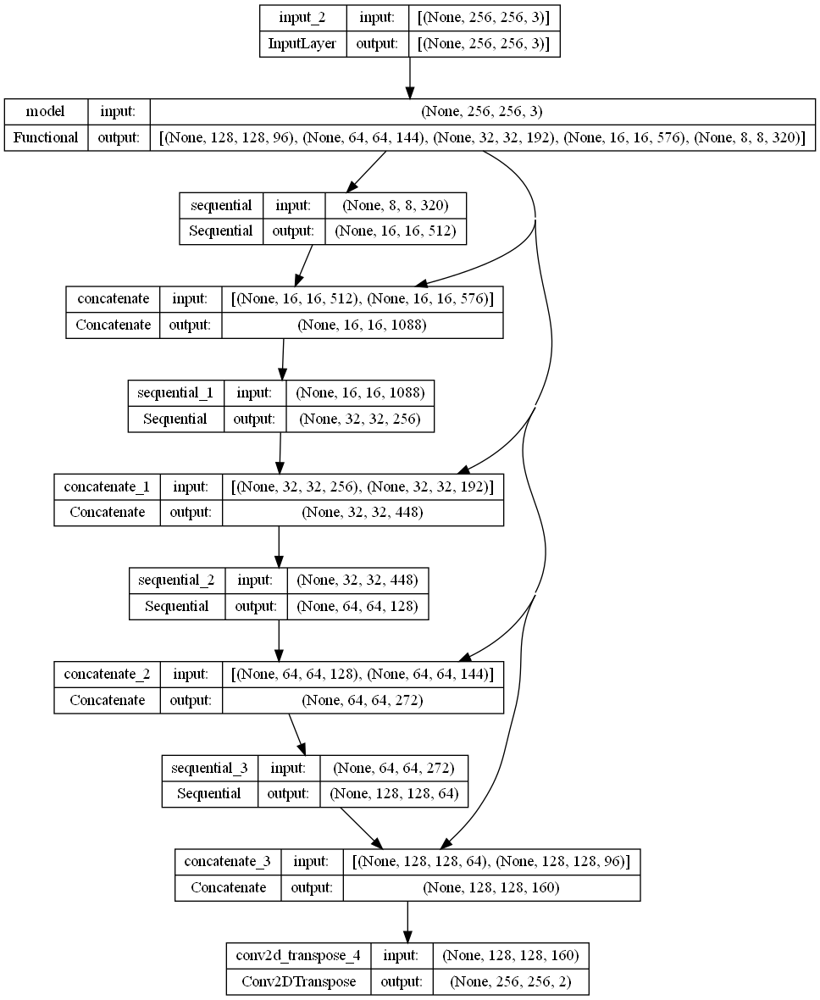

In [10]:
tf.keras.utils.plot_model(model, show_shapes = True)

In [11]:
import tensorflow.keras.backend as K
#Keras
def dice_loss(targets, inputs, smooth=1e-6):
    
    #flatten label and prediction tensors
    inputs = K.flatten(inputs)
    targets = K.flatten(targets) #tf.keras.layers.Flatten()
    
    intersection = K.sum(K.dot(targets, inputs))
    dice = (2*intersection + smooth) / (K.sum(targets) + K.sum(inputs) + smooth)
    return 1 - dice

In [12]:
#Keras
def dice_score(targets, inputs, smooth=1e-6):
    
    #flatten label and prediction tensors
    inputs = K.flatten(inputs) #tf.keras.layers.Flatten()
    targets = K.flatten(targets)
    
    intersection = K.sum(K.dot(targets, inputs))
    dice = (2*intersection + smooth) / (K.sum(targets) + K.sum(inputs) + smooth)
    return dice

In [13]:
import tensorflow.keras.backend as K
def dice_coef(y_true, y_pred):
    y_truef = K.flatten(y_true)
    y_truef = tf.cast(y_truef, tf.float32)
    y_predf = K.flatten(y_pred)
    y_predf = tf.cast(y_predf, tf.float32)
    intersection=K.sum(y_truef * y_predf)
    return((2. * intersection + 0.001) / (K.sum(y_truef) + K.sum(y_predf) + 0.001)) #1e-6 changed to 0.001

def dice_coef_loss(y_true, y_pred):
    return 1-dice_coef(y_true, y_pred)

c:\Users\chris\anaconda3\envs\encm509lab8\lib\site-packages\tensorflow\python\data\ops\structured_function.py:264: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


1/1 [==============================] - 0s 376ms/step


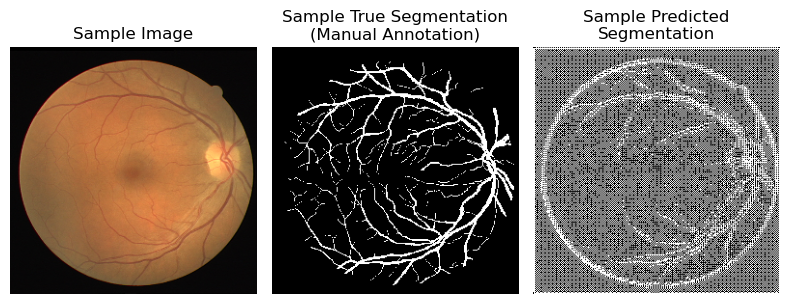

In [14]:
model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

def create_mask(pred_mask):
    pred_mask = tf.argmax(pred_mask, axis=-1)
    return pred_mask[0]

def show_predictions(dataset=None, num=1):
    if dataset:
        for image, mask in dataset.take(num):
            pred_mask = create_mask(model.predict(image))
            dice = dice_coef(pred_mask, mask[0])
            dice_l = dice_coef_loss(pred_mask, mask[0]) 
            print("Dice Coefficient = {}".format(dice))
            print("Dice Coefficient Loss = {}".format(dice_l))
            plt.subplots(1, 3, figsize=(8,8))
            plt.subplot(131);plt.imshow(image[0]); plt.title('Input Image'); plt.axis('off')
            plt.subplot(132);plt.imshow(mask[0], cmap = 'gray'); plt.title('True Segmentation\n(Manual Annotation)'); plt.axis('off')
            plt.subplot(133);plt.imshow(pred_mask, cmap = 'gray'); plt.title('Predicted Segmentation'); plt.axis('off')
    else:
        pred_mask = create_mask(model.predict(sample_image[tf.newaxis, ...]))
        plt.subplots(1, 3, figsize=(8,8))
        plt.subplot(131);plt.imshow(sample_image); plt.title('Sample Image'); plt.axis('off')
        plt.subplot(132);plt.imshow(sample_mask, cmap = 'gray'); plt.title('Sample True Segmentation\n(Manual Annotation)'); plt.axis('off')
        plt.subplot(133);plt.imshow(pred_mask, cmap = 'gray'); plt.title('Sample Predicted\nSegmentation'); plt.axis('off')
        plt.tight_layout()
    
show_predictions()

VALIDATION_STEPS -  3
Epoch 1/150
1/1 [==============================] - 0s 190ms/steps: 0.1760 - accuracy: 0.65

Sample Prediction after epoch 1

6/6 [==============================] - 7s 1s/step - loss: 0.1760 - accuracy: 0.6545 - val_loss: 0.9492 - val_accuracy: 0.3815
Epoch 2/150
1/1 [==============================] - 0s 237ms/steps: 0.1164 - accuracy: 0.89

Sample Prediction after epoch 2

6/6 [==============================] - 7s 1s/step - loss: 0.1164 - accuracy: 0.8927 - val_loss: 1.0166 - val_accuracy: 0.3426
Epoch 3/150
1/1 [==============================] - 0s 236ms/steps: 0.1028 - accuracy: 0.91

Sample Prediction after epoch 3

6/6 [==============================] - 7s 1s/step - loss: 0.1028 - accuracy: 0.9159 - val_loss: 0.9484 - val_accuracy: 0.3861
Epoch 4/150
1/1 [==============================] - 0s 276ms/steps: 0.0916 - accuracy: 0.91

Sample Prediction after epoch 4

6/6 [==============================] - 7s 1s/step - loss: 0.0916 - accuracy: 0.9148 - val_loss: 0.94

C:\Users\chris\AppData\Local\Temp\ipykernel_45532\904249139.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.subplots(1, 3, figsize=(8,8))


1/1 [==============================] - 1s 603ms/steps: 0.0545 - accuracy: 0.93

Sample Prediction after epoch 22

6/6 [==============================] - 19s 3s/step - loss: 0.0545 - accuracy: 0.9379 - val_loss: 1.4053 - val_accuracy: 0.3971
Epoch 23/150
1/1 [==============================] - 0s 389ms/steps: 0.0506 - accuracy: 0.94

Sample Prediction after epoch 23

6/6 [==============================] - 17s 3s/step - loss: 0.0506 - accuracy: 0.9410 - val_loss: 1.5496 - val_accuracy: 0.3884
Epoch 24/150
1/1 [==============================] - 0s 400ms/steps: 0.0518 - accuracy: 0.94

Sample Prediction after epoch 24

6/6 [==============================] - 18s 3s/step - loss: 0.0518 - accuracy: 0.9401 - val_loss: 1.5592 - val_accuracy: 0.3893
Epoch 25/150
1/1 [==============================] - 0s 399ms/steps: 0.0511 - accuracy: 0.94

Sample Prediction after epoch 25

6/6 [==============================] - 17s 3s/step - loss: 0.0511 - accuracy: 0.9423 - val_loss: 1.5374 - val_accuracy: 0.39

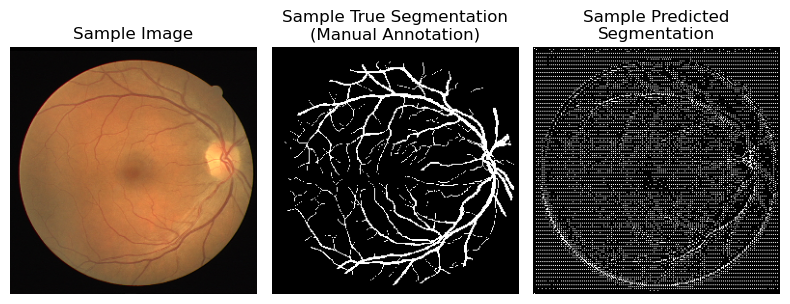

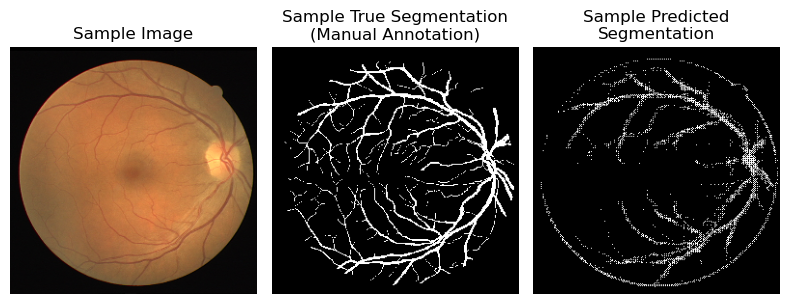

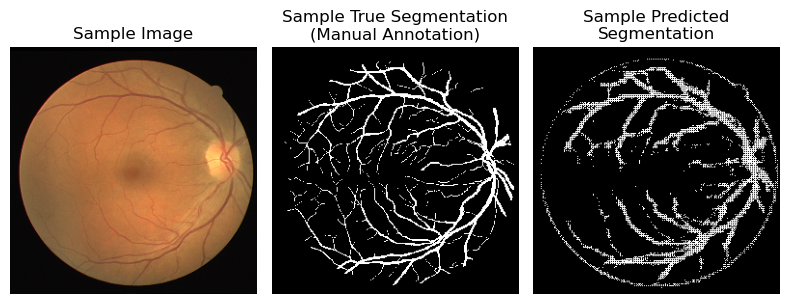

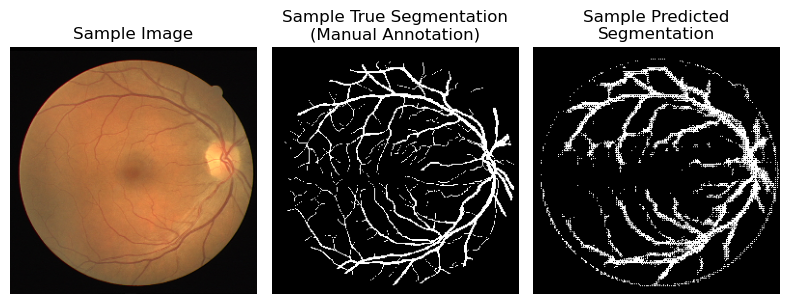

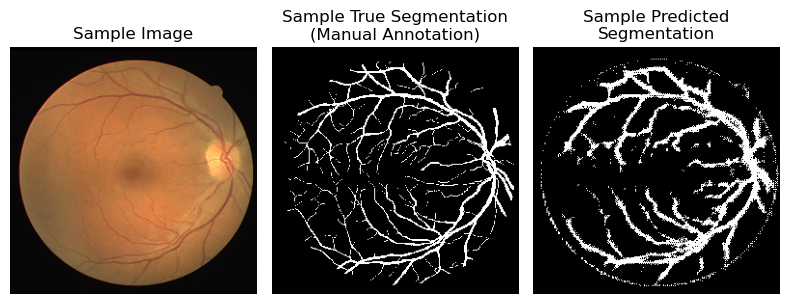

...

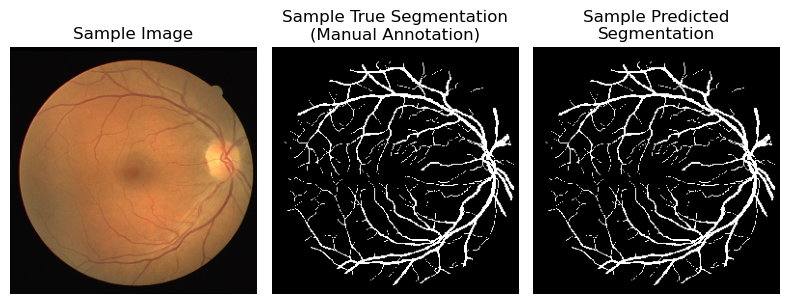

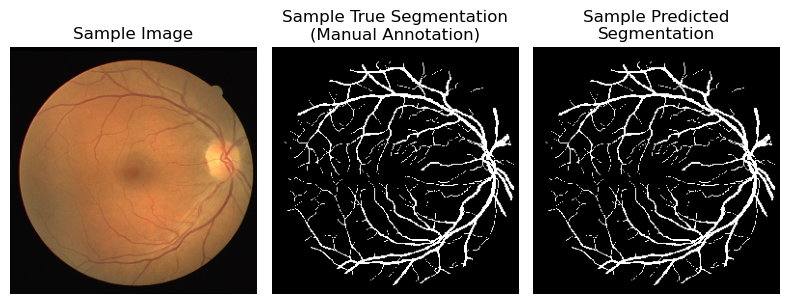

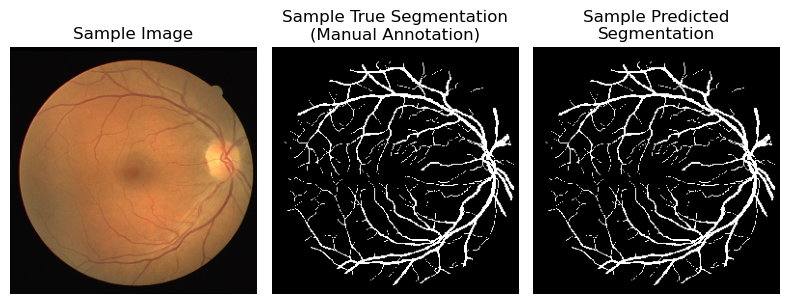

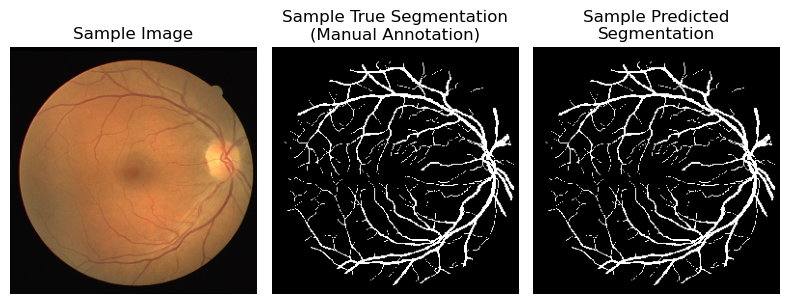

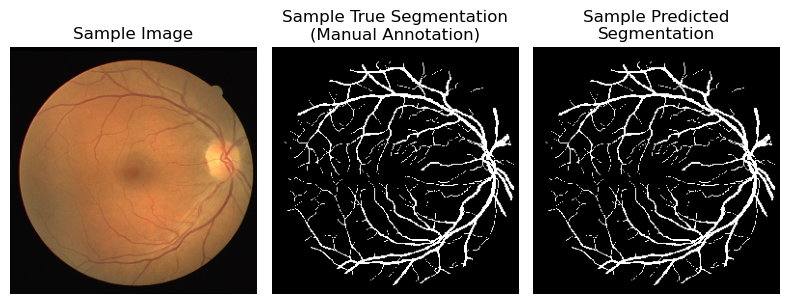

In [15]:
from IPython.display import clear_output

class DisplayCallback(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
#         clear_output(wait=True)
        show_predictions()
        print ('\nSample Prediction after epoch {}\n'.format(epoch+1))

EPOCHS = 150
VAL_SUBSPLITS = 2
VALIDATION_STEPS = len(training_images)//BATCH_SIZE//VAL_SUBSPLITS
print("VALIDATION_STEPS - ", VALIDATION_STEPS)

def add_sample_weights(image, label):
    # The weights for each class, with the constraint that:
    #     sum(class_weights) == 1.0
    class_weights = tf.constant([1.0, 4.0])
    class_weights = class_weights/tf.reduce_sum(class_weights)

# Create an image of `sample_weights` by using the label at each pixel as an 
    # index into the `class weights` .
    sample_weights = tf.gather(class_weights, indices=tf.cast(label, tf.int32))

    return image, label, sample_weights

model_history = model.fit(
    train_batches.map(add_sample_weights),
    epochs=EPOCHS,
    steps_per_epoch=STEPS_PER_EPOCH,
    validation_steps=VALIDATION_STEPS,
    validation_data=test_batches,
    callbacks=[DisplayCallback()]
)

1/1 [==============================] - 1s 904ms/step
Dice Coefficient = 1.0
Dice Coefficient Loss = 0.0
1/1 [==============================] - 1s 821ms/step
Dice Coefficient = 1.0
Dice Coefficient Loss = 0.0
1/1 [==============================] - 1s 776ms/step
Dice Coefficient = 1.0
Dice Coefficient Loss = 0.0
1/1 [==============================] - 1s 865ms/step
Dice Coefficient = 1.0
Dice Coefficient Loss = 0.0
1/1 [==============================] - 1s 727ms/step
Dice Coefficient = 1.0
Dice Coefficient Loss = 0.0
1/1 [==============================] - 1s 907ms/step
Dice Coefficient = 1.0
Dice Coefficient Loss = 0.0
1/1 [==============================] - 1s 560ms/step
Dice Coefficient = 1.0
Dice Coefficient Loss = 0.0
1/1 [==============================] - 1s 779ms/step
Dice Coefficient = 1.0
Dice Coefficient Loss = 0.0
1/1 [==============================] - 1s 744ms/step
Dice Coefficient = 1.0
Dice Coefficient Loss = 0.0
1/1 [==============================] - 1s 715ms/step
Dice Coeffi

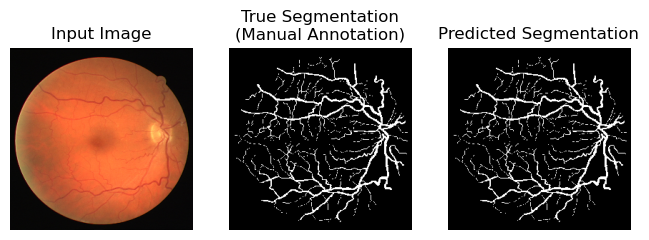

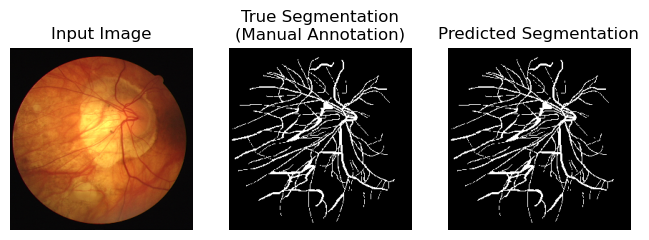

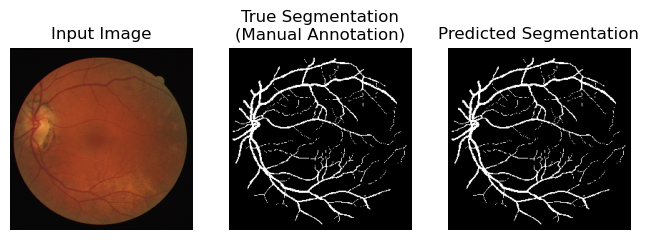

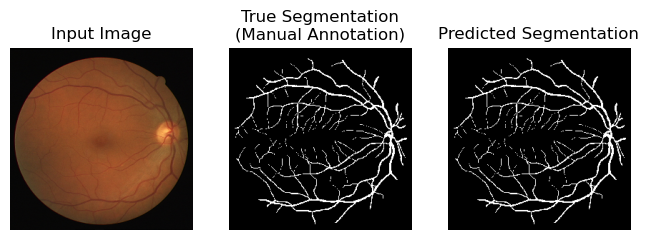

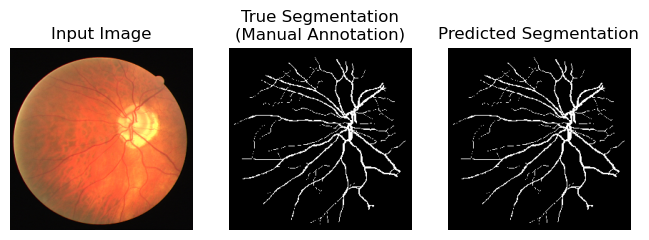

...

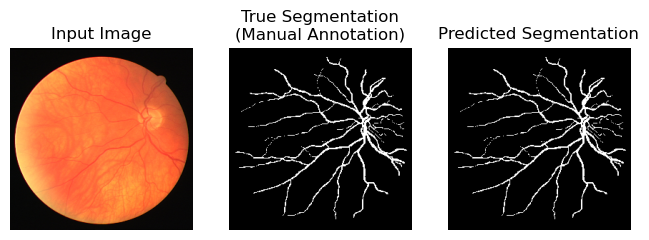

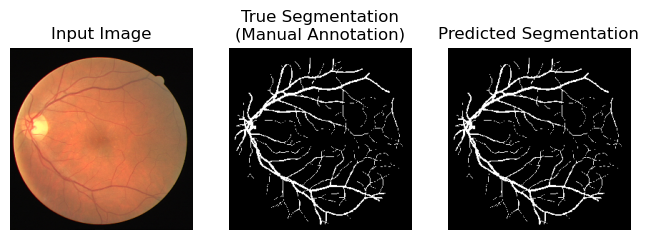

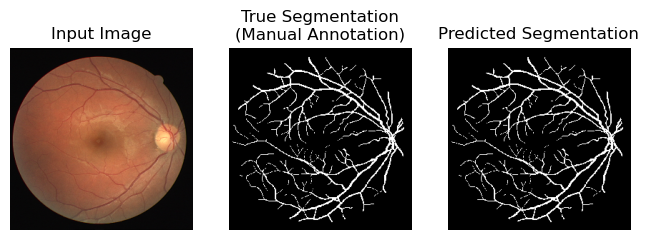

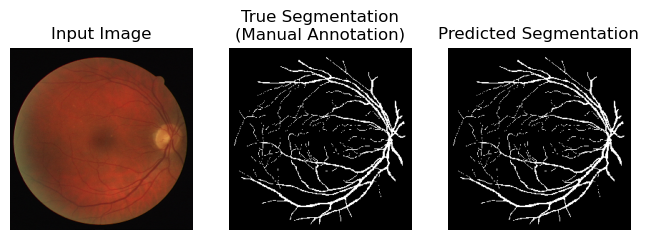

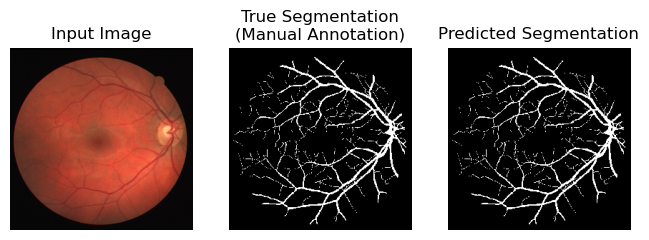

In [16]:
show_predictions(train_batches, 20)

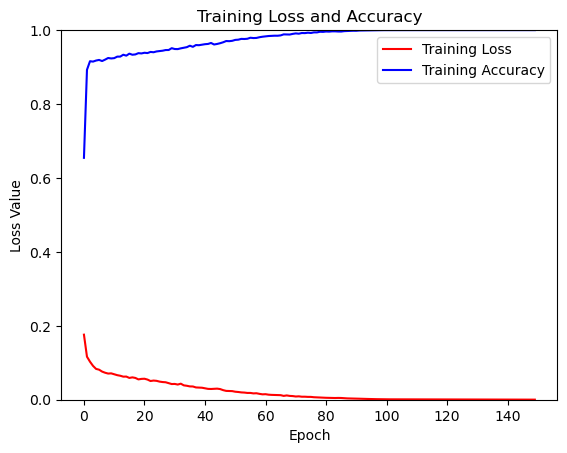

In [17]:
training_loss = model_history.history['loss']
training_accuracy = model_history.history['accuracy']

plt.figure()
plt.plot(model_history.epoch, training_loss, 'r', label='Training Loss')
plt.plot(model_history.epoch, training_accuracy, 'b', label='Training Accuracy')
plt.title('Training Loss and Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Loss Value')
plt.ylim([0, 1])
plt.legend()
plt.show()


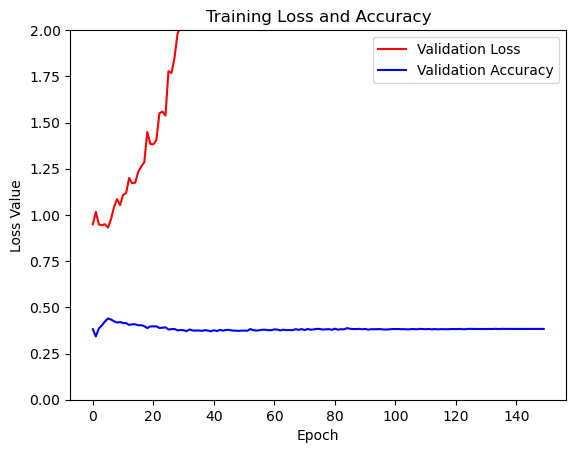

In [20]:
validation_loss = model_history.history['val_loss']
validation_accuracy = model_history.history['val_accuracy']

plt.figure()
plt.plot(model_history.epoch, validation_loss, 'r', label='Validation Loss')
plt.plot(model_history.epoch, validation_accuracy, 'b', label='Validation Accuracy')
plt.title('Training Loss and Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Loss Value')
plt.ylim([0, 2])
plt.legend()
plt.show()

1/1 [==============================] - 0s 307ms/step
Dice Coefficient = 0.21415558457374573
Dice Coefficient Loss = 0.7858444452285767
1/1 [==============================] - 0s 279ms/step
Dice Coefficient = 0.1807723492383957
Dice Coefficient Loss = 0.8192276358604431
1/1 [==============================] - 0s 264ms/step
Dice Coefficient = 0.19403135776519775
Dice Coefficient Loss = 0.8059686422348022
1/1 [==============================] - 0s 282ms/step
Dice Coefficient = 0.18286383152008057
Dice Coefficient Loss = 0.8171361684799194
1/1 [==============================] - 0s 319ms/step
Dice Coefficient = 0.18753258883953094
Dice Coefficient Loss = 0.8124673962593079
1/1 [==============================] - 0s 313ms/step
Dice Coefficient = 0.20216594636440277
Dice Coefficient Loss = 0.797834038734436
1/1 [==============================] - 0s 268ms/step
Dice Coefficient = 0.20303459465503693
Dice Coefficient Loss = 0.7969654202461243


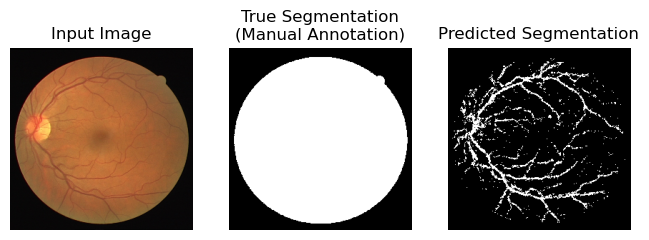

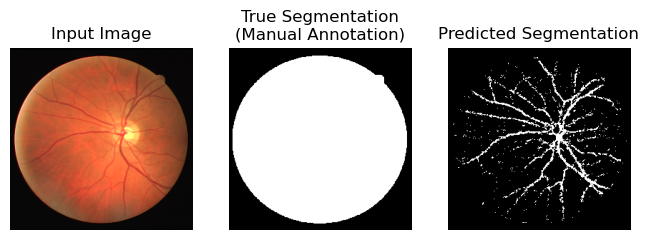

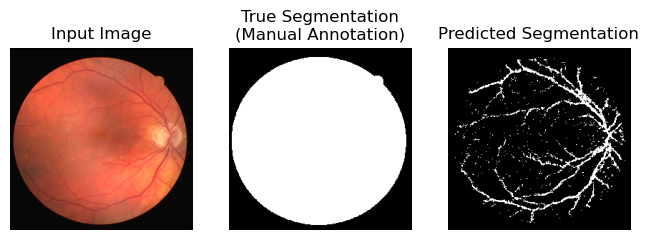

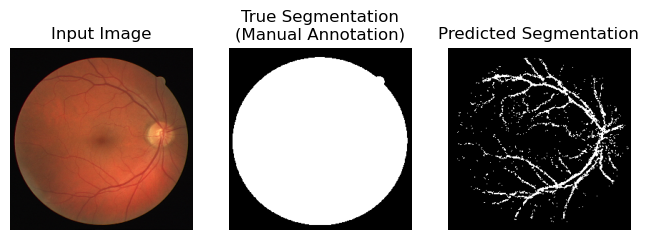

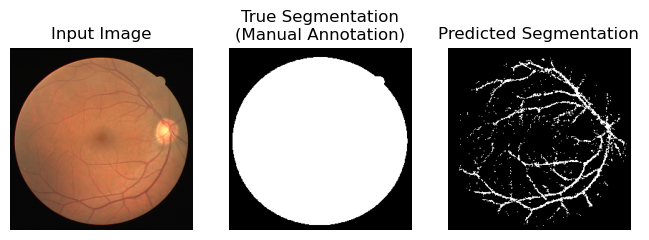

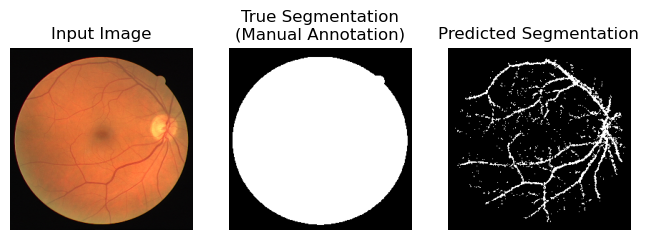

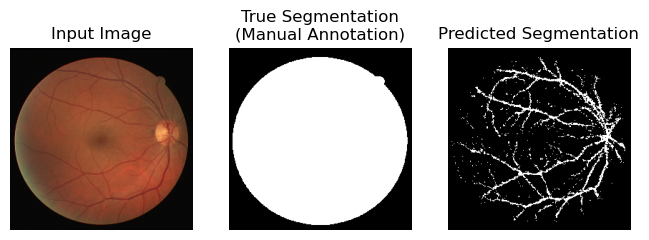

In [21]:
show_predictions(test_batches, 20)
